# Uzbekistan Fire Seasonal Analysis
## Monthly and Temporal Trend Analysis with Interactive Maps

In [1]:
# Import required libraries
import geopandas as gpd
import pandas as pd
import folium
from folium import plugins
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np
from matplotlib.gridspec import GridSpec
import calendar
import warnings
warnings.filterwarnings('ignore')

# Set style for plots
plt.style.use('dark_background')
sns.set_palette('bright')

print('Libraries imported successfully!')

Libraries imported successfully!


## 1. Load Fire Data and Uzbekistan Boundary

In [12]:
# Load FIRMS fire data
print('Loading fire data from GeoJSON...')
fires = gpd.read_file('firms_uzbekistan_2025_monthly.geojson')

# Load Uzbekistan boundary
print('Loading Uzbekistan boundary...')
uzbekistan = gpd.read_file('uz.shp')

# Convert date column to datetime
fires['date'] = pd.to_datetime(fires['date'])

# Extract temporal components
fires['year'] = fires['date'].dt.year
fires['month'] = fires['date'].dt.month
fires['month_name'] = fires['date'].dt.month_name()
fires['day'] = fires['date'].dt.day
fires['day_of_week'] = fires['date'].dt.day_name()
fires['week_of_year'] = fires['date'].dt.isocalendar().week

# Get coordinates from geometry
fires['latitude'] = fires.geometry.y
fires['longitude'] = fires.geometry.x

print(f'\nTotal fire detections: {len(fires):,}')
print(f'Date range: {fires["date"].min().date()} to {fires["date"].max().date()}')
print(f'Months covered: {fires["month_name"].unique()}')
print(f'\nColumns: {fires.columns.tolist()}')

fires.head()

Loading fire data from GeoJSON...
Loading Uzbekistan boundary...

Total fire detections: 19,480
Date range: 2025-01-04 to 2025-11-12
Months covered: ['January' 'February' 'March' 'April' 'May' 'June' 'July' 'August'
 'September' 'October' 'November']

Columns: ['id', 'T21', 'confidence', 'date', 'geometry', 'year', 'month', 'month_name', 'day', 'day_of_week', 'week_of_year', 'latitude', 'longitude']


,id,T21,confidence,date,geometry,year,month,month_name,day,day_of_week,week_of_year,latitude,longitude
0,2025004_0,303.089996,53,2025-01-04,POINT (67.31147 38.03276),2025,1,January,4,Saturday,1,38.032760,67.311474
1,2025004_1,303.089996,53,2025-01-04,POINT (67.32289 38.03276),2025,1,January,4,Saturday,1,38.032760,67.322891
2,2025004_2,303.089996,53,2025-01-04,POINT (67.33431 38.03276),2025,1,January,4,Saturday,1,38.032760,67.334309
3,2025004_3,303.089996,53,2025-01-04,POINT (67.30321 38.02377),2025,1,January,4,Saturday,1,38.023766,67.303211
4,2025004_4,303.089996,53,2025-01-04,POINT (67.31463 38.02377),2025,1,January,4,Saturday,1,38.023766,67.314628


## 2. Data Overview and Statistics

In [13]:
print('=' * 70)
print('FIRE DETECTION STATISTICS - UZBEKISTAN')
print('=' * 70)
print(f'\nTotal Detections: {len(fires):,}')
print(f'Time Period: {fires["date"].min().strftime("%B %d, %Y")} to {fires["date"].max().strftime("%B %d, %Y")}')
print(f'Number of Days: {fires["date"].dt.date.nunique()}')

print(f'\n--- Temperature Statistics (T21) ---')
print(f'Mean: {fires["T21"].mean():.2f}K')
print(f'Median: {fires["T21"].median():.2f}K')
print(f'Min: {fires["T21"].min():.2f}K')
print(f'Max: {fires["T21"].max():.2f}K')

print(f'\n--- Confidence Levels ---')
print(f'Mean: {fires["confidence"].mean():.1f}')
print(f'Min: {fires["confidence"].min()}')
print(f'Max: {fires["confidence"].max()}')

print(f'\n--- Daily Statistics ---')
daily_counts = fires.groupby(fires['date'].dt.date).size()
print(f'Average fires per day: {daily_counts.mean():.1f}')
print(f'Max fires in a day: {daily_counts.max()} (on {daily_counts.idxmax()})')
print(f'Min fires in a day: {daily_counts.min()} (on {daily_counts.idxmin()})')
print('=' * 70)

FIRE DETECTION STATISTICS - UZBEKISTAN

Total Detections: 19,480
Time Period: January 04, 2025 to November 12, 2025
Number of Days: 291

--- Temperature Statistics (T21) ---
Mean: 322.20K
Median: 318.85K
Min: 300.66K
Max: 438.67K

--- Confidence Levels ---
Mean: 71.6
Min: 40
Max: 100

--- Daily Statistics ---
Average fires per day: 66.9
Max fires in a day: 608 (on 2025-03-16)
Min fires in a day: 2 (on 2025-02-07)


## 3. Interactive Map - All Fires (Dark Matter Basemap)

In [14]:
# Calculate center of Uzbekistan
center_lat = uzbekistan.geometry.centroid.y.values[0]
center_lon = uzbekistan.geometry.centroid.x.values[0]

# Create base map with dark matter tiles
m_all = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=6,
    tiles='CartoDB dark_matter',
    attr='CartoDB Dark Matter'
)

# Add Uzbekistan boundary
folium.GeoJson(
    uzbekistan,
    name='Uzbekistan Boundary',
    style_function=lambda x: {
        'fillColor': 'transparent',
        'color': '#00ff00',
        'weight': 3,
        'fillOpacity': 0.1
    }
).add_to(m_all)

# Color code fires by temperature
temp_min = fires['T21'].min()
temp_max = fires['T21'].max()

def get_color_by_temp(temp):
    """Return color based on temperature"""
    normalized = (temp - temp_min) / (temp_max - temp_min)
    if normalized < 0.33:
        return '#FFA500'  # Orange
    elif normalized < 0.66:
        return '#FF4500'  # Red-Orange
    else:
        return '#FF0000'  # Red

# Add fire points
for idx, row in fires.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=4,
        popup=f"""<b>Fire Detection</b><br>
        Date: {row['date'].strftime('%Y-%m-%d')}<br>
        Temperature: {row['T21']:.1f}K<br>
        Confidence: {row['confidence']}<br>
        Day of Week: {row['day_of_week']}""",
        color=get_color_by_temp(row['T21']),
        fillColor=get_color_by_temp(row['T21']),
        fillOpacity=0.7,
        weight=1
    ).add_to(m_all)

# Add heatmap layer
heat_data = [[row['latitude'], row['longitude'], row['T21']] for idx, row in fires.iterrows()]
plugins.HeatMap(
    heat_data,
    name='Temperature Heatmap',
    min_opacity=0.3,
    max_zoom=13,
    radius=15,
    blur=20,
    gradient={0.4: 'blue', 0.6: 'yellow', 0.8: 'orange', 1.0: 'red'}
).add_to(m_all)

# Add layer control
folium.LayerControl().add_to(m_all)

# Add title
title_html = '''<div style="position: fixed; 
                top: 10px; left: 50px; width: 450px; height: 80px; 
                background-color: rgba(0, 0, 0, 0.8); border-radius: 5px;
                z-index: 9999; font-size: 14px; color: white; padding: 10px;">
                <b style="font-size: 16px;">Fire Detections in Uzbekistan</b><br>
                Period: {} to {}<br>
                Total Fires: {}</div>'''.format(
    fires['date'].min().strftime('%b %d, %Y'),
    fires['date'].max().strftime('%b %d, %Y'),
    len(fires)
)
m_all.get_root().html.add_child(folium.Element(title_html))

# Save map
m_all.save('map_all_fires.html')
print('Map saved as: map_all_fires.html')

m_all

Map saved as: map_all_fires.html


## 4. Daily Fire Maps Animation

In [30]:
# --- MONTHLY FIRE POINT ANIMATION ---

# Create map
m_time = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=6,
    tiles='CartoDB dark_matter'
)

# Add boundary
folium.GeoJson(
    uzbekistan,
    style_function=lambda x: {
        'fillColor': 'transparent', 
        'color': '#00ff00', 
        'weight': 2
    }
).add_to(m_time)

# Create "year-month" field
fires['year_month'] = fires['date'].dt.to_period('M').astype(str)

# Prepare TimestampedGeoJson features
features = []

# Loop: for each month → include ALL points of the month
for month, df_month in fires.groupby('year_month'):
    for idx, row in df_month.iterrows():
        feature = {
            'type': 'Feature',
            'geometry': {
                'type': 'Point',
                'coordinates': [row['longitude'], row['latitude']]
            },
            'properties': {
                'time': month + "-01",   # all points appear on the same frame per month
                'popup': f"<b>{month}</b><br>"
                         f"Date: {row['date'].strftime('%Y-%m-%d')}<br>"
                         f"Temp: {row['T21']:.1f}K<br>"
                         f"Confidence: {row['confidence']}",
                'icon': 'circle',
                'iconstyle': {
                    'fillColor': get_color_by_temp(row['T21']),
                    'fillOpacity': 0.7,
                    'stroke': 'true',
                    'radius': 5
                }
            }
        }
        features.append(feature)

# Add to map
plugins.TimestampedGeoJson(
    {'type': 'FeatureCollection', 'features': features},
    period='P1M',          # change each month
    add_last_point=False,
    auto_play=False,
    loop=True,
    max_speed=1,
    loop_button=True,
    date_options='YYYY-MM',
    time_slider_drag_update=True,
    duration='P1M'        # each frame = one month
).add_to(m_time)

m_time.save('map_monthly_fire_animation.html')

m_time


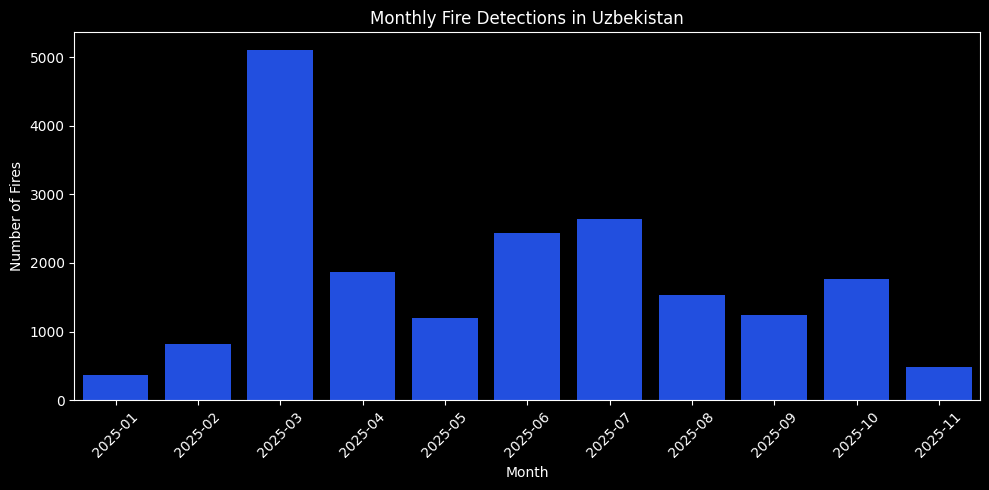

In [23]:
# ---- 1. MONTHLY FIRE COUNTS ----

# Use year_month created earlier
fire_monthly = fires.groupby('year_month').size().reset_index(name='fire_count')

plt.figure(figsize=(10,5))
sns.barplot(data=fire_monthly, x='year_month', y='fire_count')
plt.title("Monthly Fire Detections in Uzbekistan")
plt.xlabel("Month")
plt.ylabel("Number of Fires")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
